<a href="https://colab.research.google.com/github/mskv99/Defect-Detection/blob/main/custom_faster_rcnn_training_colab.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Clone the Repository

In [ ]:
!git clone https://github.com/sovit-123/fastercnn-pytorch-training-pipeline.git

Cloning into 'fastercnn-pytorch-training-pipeline'...
remote: Enumerating objects: 1212, done.
remote: Counting objects: 100% (309/309), done.
remote: Compressing objects: 100% (73/73), done.
remote: Total 1212 (delta 245), reused 237 (delta 236), pack-reused 903
Receiving objects: 100% (1212/1212), 10.55 MiB | 24.16 MiB/s, done.
Resolving deltas: 100% (827/827), done.


In [ ]:
!pip install vision_transformers

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
  Preparing metadata (setup.py) ... done
  Created wheel for vision_transformers: filename=vision_transformers-0.1.1.0-py3-none-any.whl size=48416 sha256=4e4bf2fbde220d42431562a689e231d4540a07f8fe06d3a7422c86823b8b558c
  Stored in directory: /root/.cache/pip/wheels/02/f4/94/0a5c8d2a4fcb6aa4c590906ffd3d52dc8edbe94262ecaa7dae
Successfully built vision_transformers


In [ ]:
# Enter the repo directory.
%cd fastercnn-pytorch-training-pipeline/

/content/fastercnn-pytorch-training-pipeline


In [ ]:
# Install the Requirements
!pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


## Download the Dataset

Here we are using the [Aquarium Dataset](https://public.roboflow.com/object-detection/aquarium) from Roboflow.

Download the unzip the dataset to `custom_data` directory.

In [ ]:
!curl -L "https://app.roboflow.com/ds/UKv4tybmhd?key=cS4UxrytMH" > roboflow.zip; unzip roboflow.zip -d custom_data; rm roboflow.zip

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   891  100   891    0     0   2741      0 --:--:-- --:--:-- --:--:--  2733
100 44.1M  100 44.1M    0     0  47.1M      0 --:--:-- --:--:-- --:--:-- 47.1M
Archive:  roboflow.zip
 extracting: custom_data/README.dataset.txt  
 extracting: custom_data/README.roboflow.txt  
   creating: custom_data/test/
 extracting: custom_data/test/E04_M0176-01MS_jpg.rf.10192e849d83b930b4f63b5b6b090480.jpg  
 extracting: custom_data/test/E04_M0176-01MS_jpg.rf.10192e849d83b930b4f63b5b6b090480.xml  
 extracting: custom_data/test/E04_M0262-01MS_jpg.rf.db83e4c027bc897fb09f42b1c5ac4b99.jpg  
 extracting: custom_data/test/E04_M0262-01MS_jpg.rf.db83e4c027bc897fb09f42b1c5ac4b99.xml  
 extracting: custom_data/test/E04_M0316-01MS_jpg.rf.2f1f514b47efb0b30330a82b3ee5c560.jpg  
 extracting: custom_data/test/E04_M0316-01MS_jpg.rf.2f1f514b47efb0b30330a82b3ee5c5

## Create the Custom Dataset YAML File.

In [ ]:
%%writefile data_configs/custom_data.yaml
# Images and labels direcotry should be relative to train.py
TRAIN_DIR_IMAGES: '/content/fastercnn-pytorch-training-pipeline/custom_data/train'
TRAIN_DIR_LABELS: '/content/fastercnn-pytorch-training-pipeline/custom_data/train'
VALID_DIR_IMAGES: '/content/fastercnn-pytorch-training-pipeline/custom_data/valid'
VALID_DIR_LABELS: '/content/fastercnn-pytorch-training-pipeline/custom_data/valid'

# Class names.
CLASSES: [
    '__background__',
  'bridge', 'collapse', 
  'gap', 'non-bridge', 
  'normal', 'sraf'
]

# Number of classes (object classes + 1 for background class in Faster RCNN).
NC: 7

# Whether to save the predictions of the validation set while training.
SAVE_VALID_PREDICTION_IMAGES: True

Writing data_configs/custom_data.yaml


In [ ]:
!python train.py --data /content/fastercnn-pytorch-training-pipeline/data_configs/custom_data.yaml\
--epochs 20 --model fasterrcnn_resnet50_fpn --batch 16\
--no-mosaic


2023-05-30 14:49:16.410720: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-30 14:49:17.741094: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Not using distributed mode
wandb: Currently logged in as: andrew_mskv (ml_team_mskv). Use `wandb login --relogin` to force relogin
wandb: Tracking run with wandb version 0.15.3
wandb: Run data is saved locally in /content/fastercnn-pytorch-training-pipeline/wandb/run-20230530_144921-7v0mbiof
wandb: Run `wandb offline` to turn off syncing.
wandb: Syncing run feasible-thunder-3
wandb: ⭐️ View project at https://wandb.ai/ml_team_mskv/fastercnn-pytorch-training-pipeline
wandb: 🚀 View run at https://wandb.ai/ml_team_mskv/fastercnn-pytorch-training-pipeline/runs/7

## Training

In [ ]:

!python train.py --data /content/fastercnn-pytorch-training-pipeline/data_configs/custom_data.yaml\
--epochs 20 --model fasterrcnn_resnet50_fpn --batch 16\
--no-mosaic -wd



2023-05-30 14:27:20.994613: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-30 14:27:21.957241: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Not using distributed mode
wandb: (1) Create a W&B account
wandb: (2) Use an existing W&B account
wandb: (3) Don't visualize my results
wandb: Enter your choice: 1
wandb: You chose 'Create a W&B account'
wandb: Create an account here: https://wandb.ai/authorize?signup=true
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit: 
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Tracking run with wandb version 0.15.3
wandb: Run data is saved locally in /content/fastercnn-pytorch-training-pipeline/wandb/run

## Visualize Validation Results

In [ ]:
import matplotlib.pyplot as plt
import glob as glob

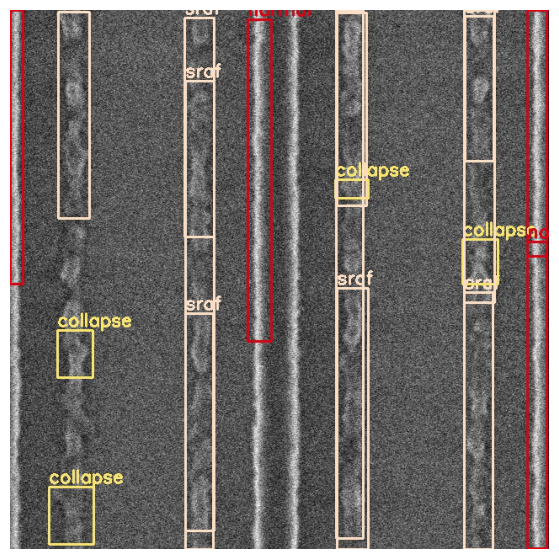

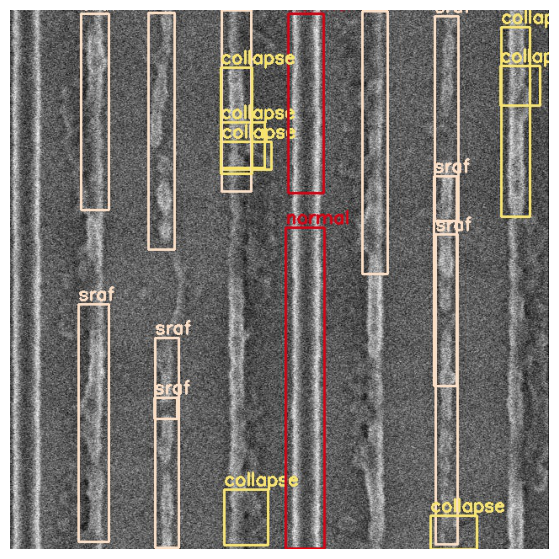

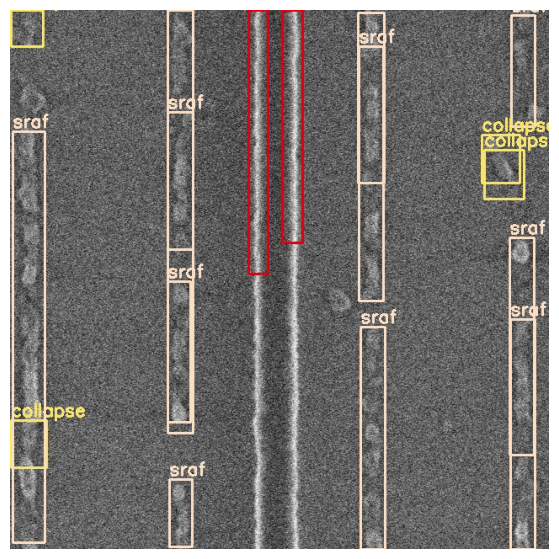

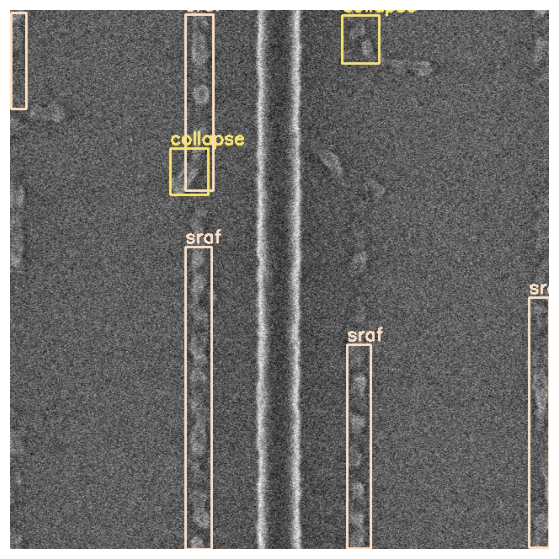

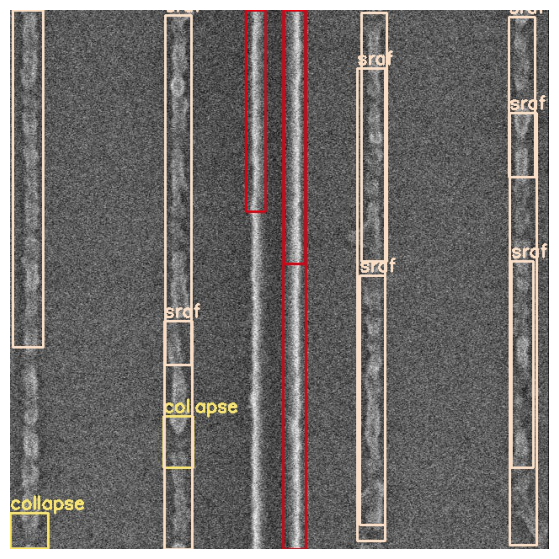

...

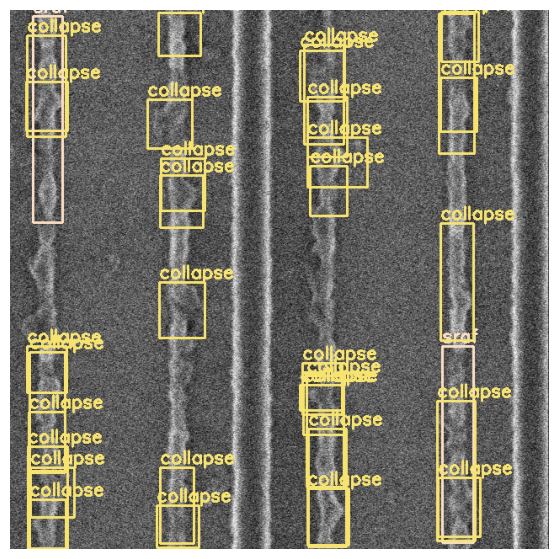

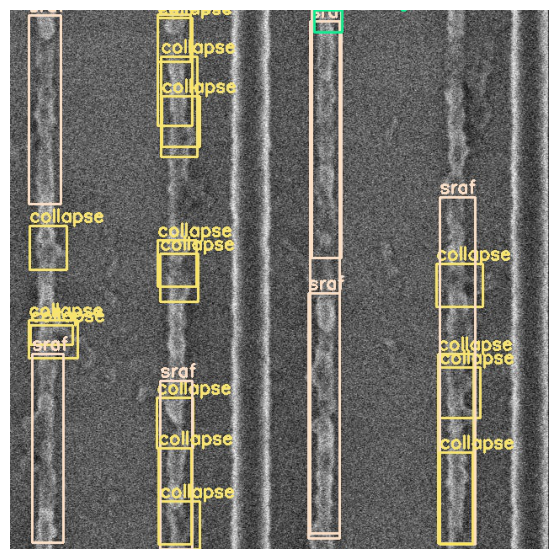

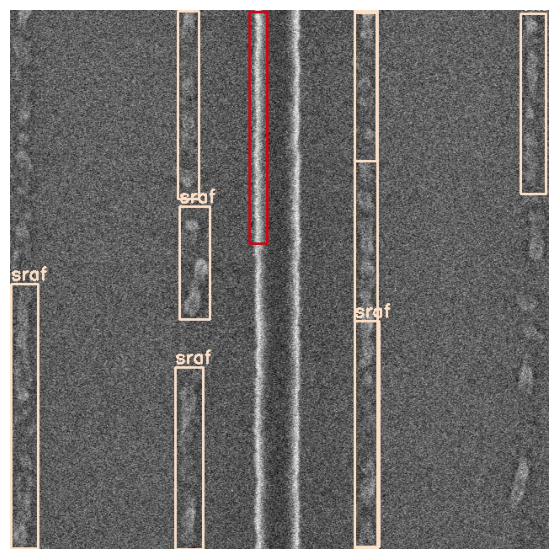

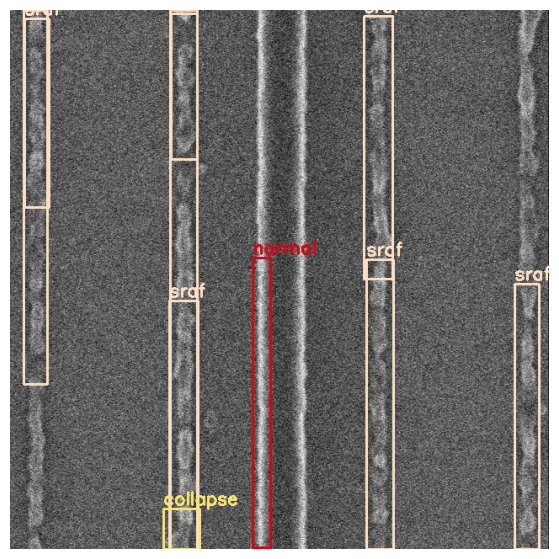

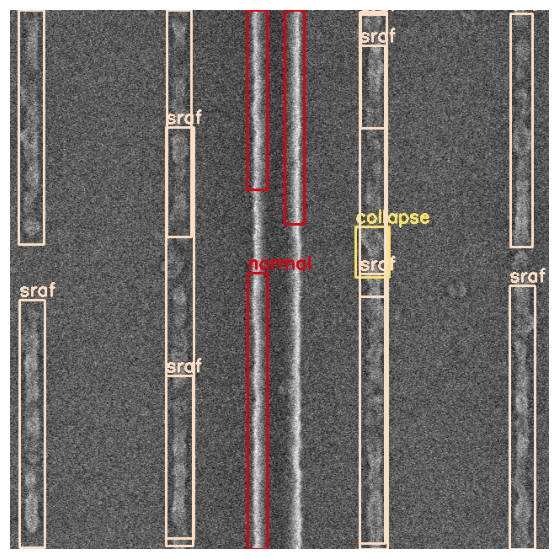

IndexError: ignored

<Figure size 1000x700 with 0 Axes>

In [ ]:
results_dir_path = '/content/fastercnn-pytorch-training-pipeline/outputs/training/results'
valid_images = glob.glob(f"{results_dir_path}/*.jpg")

for i in range(68):
    plt.figure(figsize=(10, 7))
    image = plt.imread(valid_images[i])
    plt.imshow(image)
    plt.axis('off')
    plt.show()

In [ ]:
import os 

len(os.listdir('/content/fastercnn-pytorch-training-pipeline/custom_data/valid'))



136

In [ ]:
!python inference.py


Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_v2_coco-dd69338a.pth
100% 167M/167M [00:01<00:00, 99.8MB/s]
Test instances: 1
Image 1 done...
--------------------------------------------------
TEST PREDICTIONS COMPLETE
Average FPS: 0.173


In [ ]:
!python eval.py --model fasterrcnn_resnet50_fpn_v2 --weights /content/fastercnn-pytorch-training-pipeline/outputs/training/results/best_model.pth\
--data /content/fastercnn-pytorch-training-pipeline/data_configs/custom_data.yaml --batch 16 --verbose


2023-05-29 11:53:46.465077: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-29 11:53:47.550481: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Traceback (most recent call last):
  File "/content/fastercnn-pytorch-training-pipeline/eval.py", line 121, in <module>
    model.load_state_dict(checkpoint['model_state_dict'])
  File "/usr/local/lib/python3.10/dist-packages/torch/nn/modules/module.py", line 2041, in load_state_dict
    raise RuntimeError('Error(s) in loading state_dict for {}:\n\t{}'.format(
RuntimeError: Error(s) in loading state_dict for FasterRCNN:
	Missing key(s) in state_dict: "backbone.fpn.inner_blocks.0.1.weight", "backbone.fpn.inner_blocks.0.1.bias", "backbone.fpn.inner_blo

In [ ]:
!python eval.py --data '/content/fastercnn-pytorch-training-pipeline/data_configs/custom_data.yaml'\
--weights '/content/fastercnn-pytorch-training-pipeline/outputs/training/results/best_model.pth' --verbose


2023-05-29 12:42:28.906216: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-29 12:42:30.009874: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(
100% 9/9 [00:09<00:00,  1.06s/it]


{'map': tensor(0.0476),
 'map_50': tensor(0.1

In [ ]:
import glob as glob

test_img = glob.glob("/content/fastercnn-pytorch-training-pipeline/custom_data/test/*.jpg")
print(test_img)


['/content/fastercnn-pytorch-training-pipeline/custom_data/test/E04_M0699-01MS_jpg.rf.dfe2e62feed0c889d9ae8c60b18b5895.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S14_M0133-01MS_jpg.rf.63067176c2983f373ad3db4700e6475e.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S04_M1107-01MS_jpg.rf.0015226e5debf4d53ae50324b3640f64.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S14_M0001-01MS_jpg.rf.f9744dcaa9fd8da4c905514652e05ede.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/E04_M0603-01MS_jpg.rf.877acab5896e5a2857fd7fab165d4708.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S14_M1288-01MS_jpg.rf.b9c6fa1a76db71d008d3a927ebc23322.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S14_M0041-01MS_jpg.rf.004480cc6481724acf2a06f4752346c3.jpg', '/content/fastercnn-pytorch-training-pipeline/custom_data/test/S14_M0085-01MS_jpg.rf.ab8e784bd1d485199449c96496f8ed70.jpg', '/conte

In [ ]:
!python inference.py --input '/content/fastercnn-pytorch-training-pipeline/custom_data/test' --weights '/content/fastercnn-pytorch-training-pipeline/outputs/training/results/best_model.pth'


Building from model name arguments...
Test instances: 32
Image 1 done...
--------------------------------------------------
Image 2 done...
--------------------------------------------------
Image 3 done...
--------------------------------------------------
Image 4 done...
--------------------------------------------------
Image 5 done...
--------------------------------------------------
Image 6 done...
--------------------------------------------------
Image 7 done...
--------------------------------------------------
Image 8 done...
--------------------------------------------------
Image 9 done...
--------------------------------------------------
Image 10 done...
--------------------------------------------------
Image 11 done...
--------------------------------------------------
Image 12 done...
--------------------------------------------------
Image 13 done...
--------------------------------------------------
Image 14 done...
--------------------------------------------------


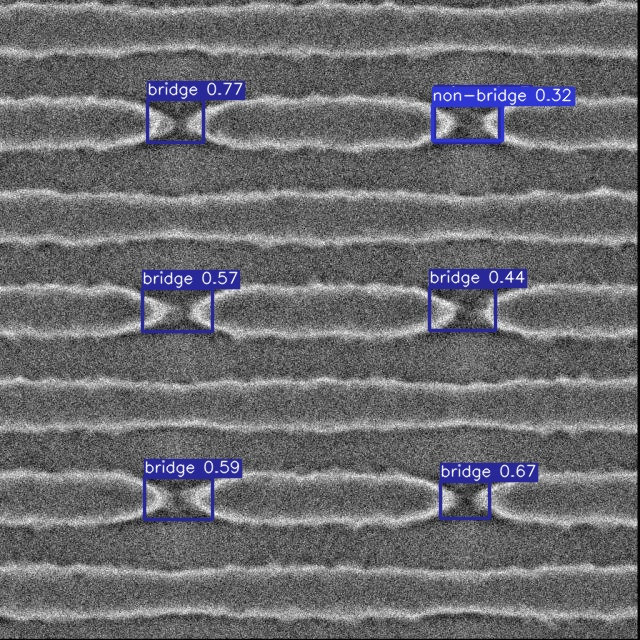

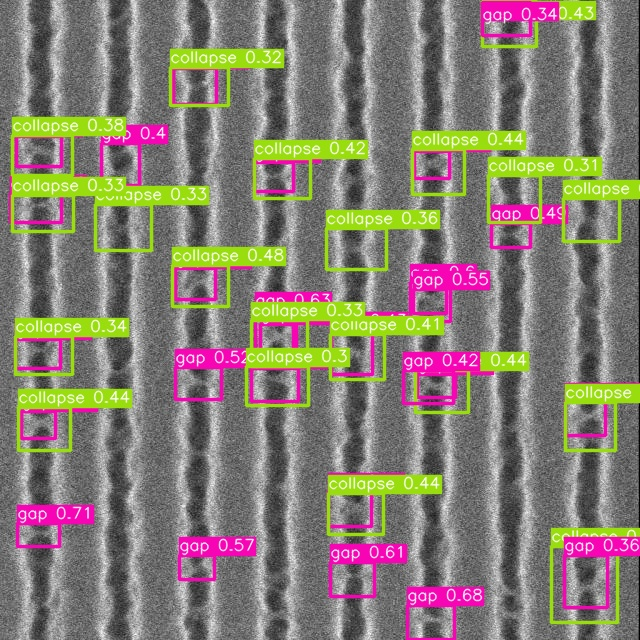

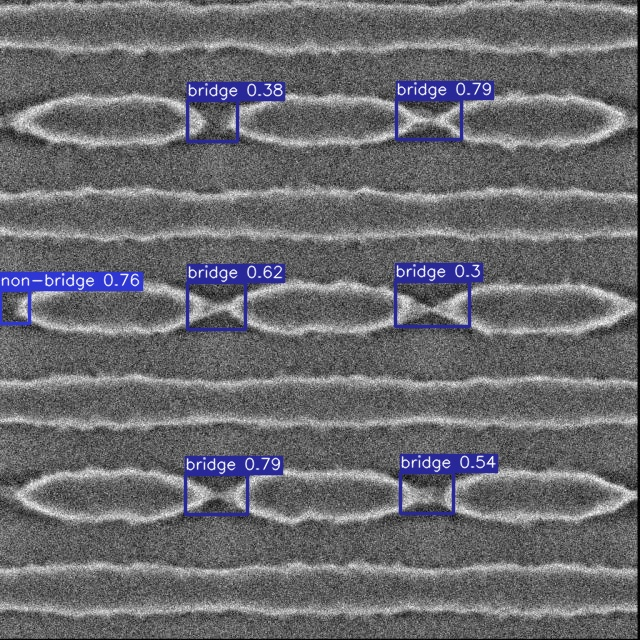

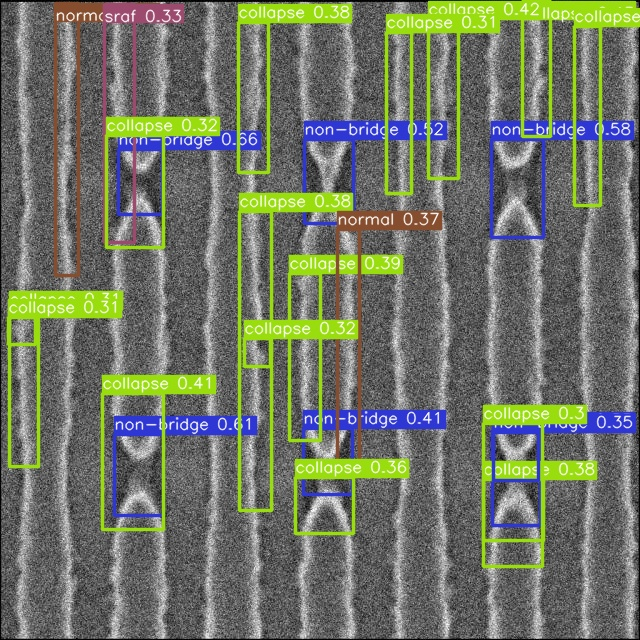

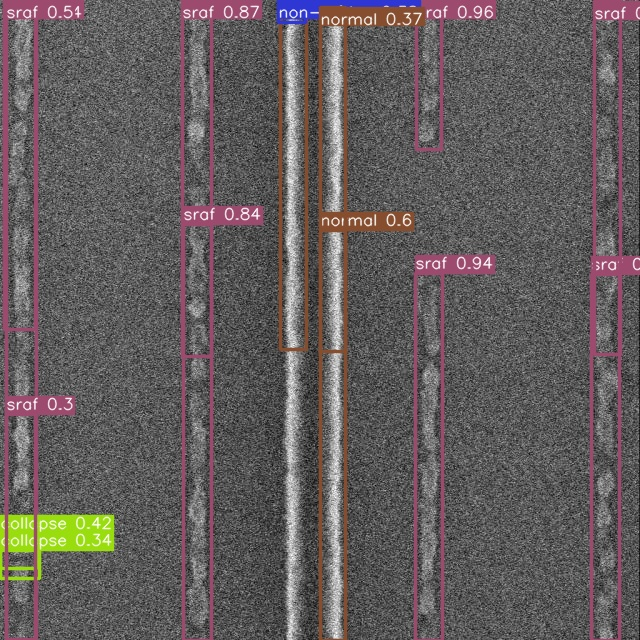

...

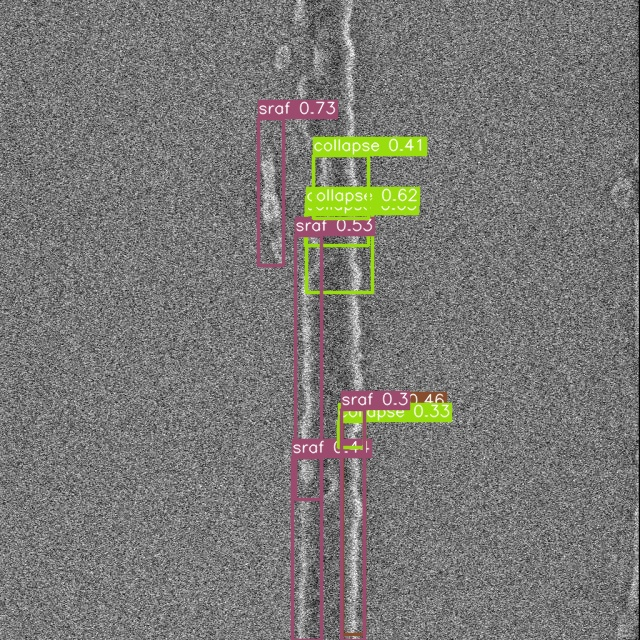

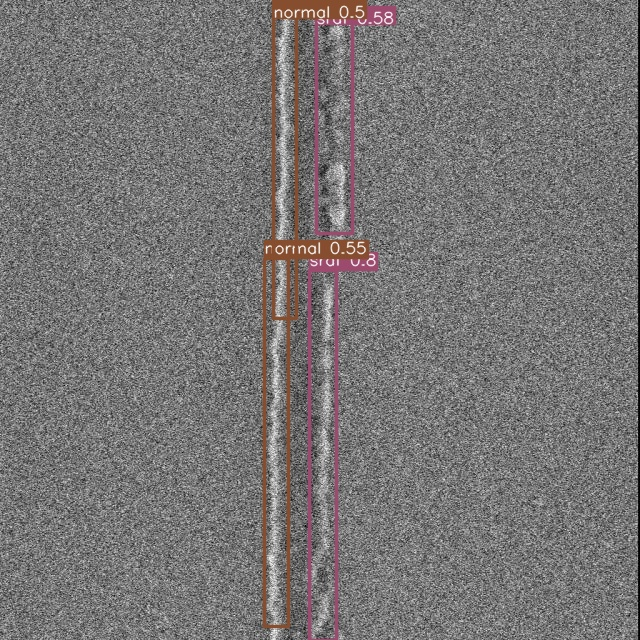

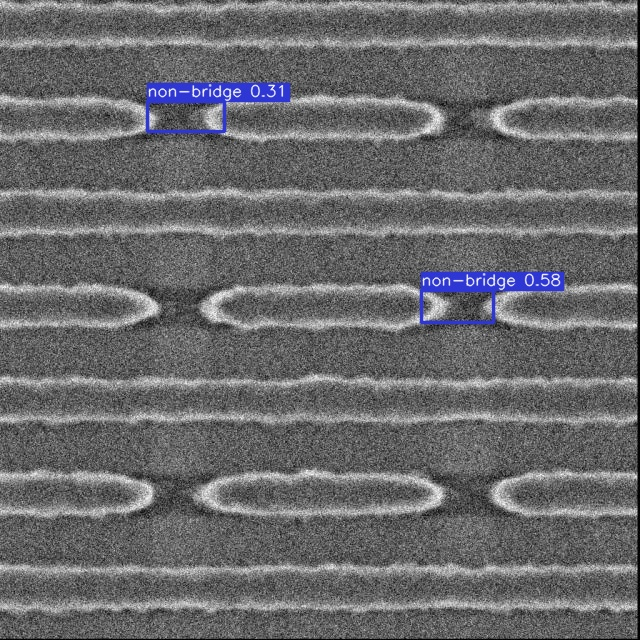

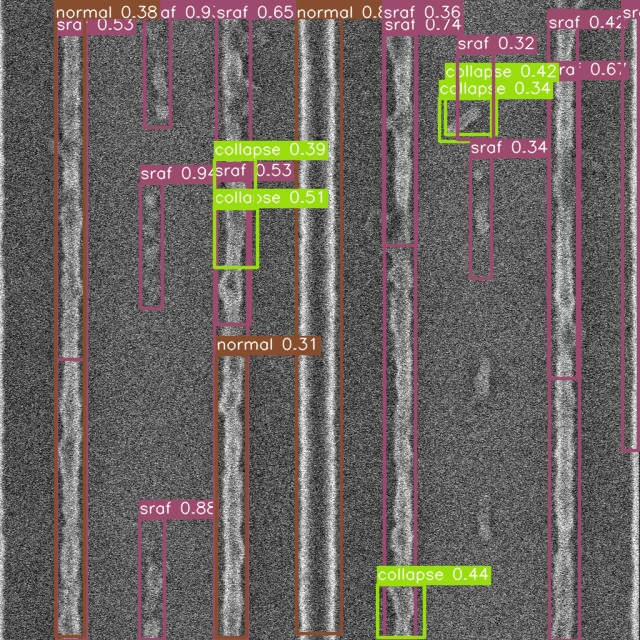

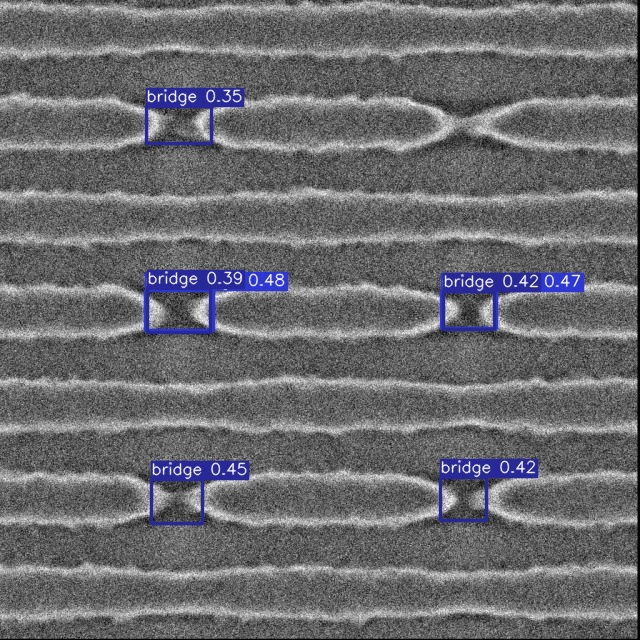

In [ ]:
import glob 
from IPython.display import Image, display

for imageName in glob.glob('/content/fastercnn-pytorch-training-pipeline/outputs/inference/res_3/*.jpg'):
  display(Image(filename=imageName))
  print('\n')


In [ ]:
!pwd

/content/fastercnn-pytorch-training-pipeline


In [ ]:
!python datasets.py